In [ ]:
# 구글 드라이브 연동
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# zip파일 풀기
!unzip -qq "/content/drive/My Drive/face2comic.zip"

In [ ]:
import numpy as np
import tensorflow as tf
import cv2 
import os
import matplotlib.pyplot as plt

In [ ]:
PATH='./face2comics_v1.0.0_by_Sxela/face2comics_v1.0.0_by_Sxela'
BUFFER_SIZE = 1000
BATCH_SIZE = 10
IMG_WIDTH = 512
IMG_HEIGHT = 512

### 이미지 데이터셋 확인

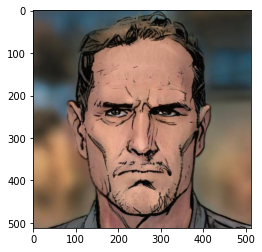

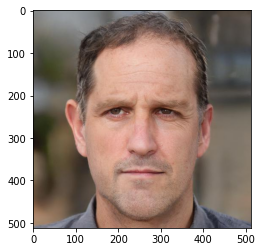

In [ ]:
images=os.listdir('./face2comics_v1.0.0_by_Sxela/face2comics_v1.0.0_by_Sxela/comics')
## train_data
plt.figure()
img = cv2.imread('./face2comics_v1.0.0_by_Sxela/face2comics_v1.0.0_by_Sxela/comics/1.jpg')
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb);

## test_data
plt.figure()
img = cv2.imread('./face2comics_v1.0.0_by_Sxela/face2comics_v1.0.0_by_Sxela/face/1.jpg')
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img_rgb);

In [ ]:
def load_input(image_file1):
  input_image= tf.io.read_file(image_file1)
  input_image= tf.image.decode_jpeg(input_image)
  input_image = tf.cast(input_image, tf.float32)
  return input_image# real_image

In [ ]:
def resize(input_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  return input_image

In [ ]:
def normalize(input_image):
  input_image = (input_image / 127.5) - 1
  return input_image

In [ ]:
@tf.function()
def random_jitter(input_image):

  input_image, real_image = resize(input_image, 600, 600)

  if tf.random.uniform(()) > 0.5:

    input_image = tf.image.flip_left_right(input_image)
    
  return input_image, real_image

In [ ]:
def load_image_train(image_file1):
  input_image= load_input(image_file1)
  input_image = normalize(input_image)
  return input_image

In [ ]:
train_dataset_inp=tf.data.Dataset.list_files(PATH+'/face/*.jpg',shuffle=False,)
train_dataset_inp=train_dataset_inp.map(load_image_train,num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset_inp=train_dataset_inp.batch(BATCH_SIZE)

train_dataset_real=tf.data.Dataset.list_files(PATH+'/comics/*.jpg',shuffle=False)
train_dataset_real=train_dataset_real.map(load_image_train,num_parallel_calls=tf.data.experimental.AUTOTUNE)
train_dataset_real=train_dataset_real.batch(BATCH_SIZE)

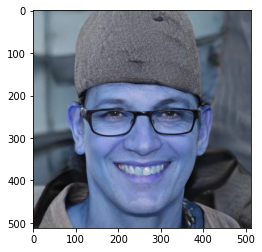

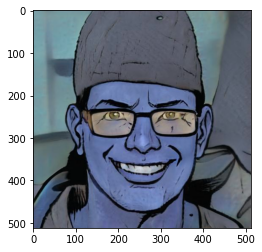

In [ ]:
inp=cv2.imread('./face2comics_v1.0.0_by_Sxela/face2comics_v1.0.0_by_Sxela/face/1000.jpg')
real=cv2.imread('./face2comics_v1.0.0_by_Sxela/face2comics_v1.0.0_by_Sxela/comics/1000.jpg')
plt.figure()
plt.imshow(inp);
plt.figure()
plt.imshow(real);

In [ ]:
OUTPUT_CHANNELS = 3
def downsample(filters,size,apply_batchnorm=True):
    
    initializer=tf.random_normal_initializer(0.,0.02)
    result=tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))
    
    if apply_batchnorm:
        result.add(tf.keras.layers.BatchNormalization())

    result.add(tf.keras.layers.LeakyReLU())
    return result

In [ ]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [ ]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[512, 512, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (bs, 128, 128, 64)
    downsample(128, 4),  # (bs, 64, 64, 128)
    downsample(256, 4),  # (bs, 32, 32, 256)
    downsample(512, 4),  # (bs, 16, 16, 512)
    downsample(512, 4),
    downsample(512, 4),  # (bs, 8, 8, 512)
    downsample(512, 4),  # (bs, 4, 4, 512)
    downsample(512, 4),  # (bs, 2, 2, 512)
    downsample(512, 4),  # (bs, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (bs, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (bs, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (bs, 8, 8, 1024)
    upsample(512, 4),  # (bs, 16, 16, 1024)
    upsample(512, 4),
    upsample(256, 4),  # (bs, 32, 32, 512)
    upsample(128, 4),  # (bs, 64, 64, 256)
    upsample(64, 4),  # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (bs, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


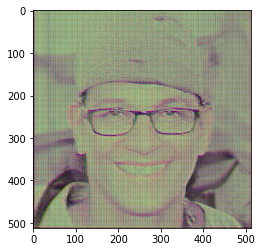

In [ ]:
generator = Generator()
#tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])

LAMBDA = 100
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

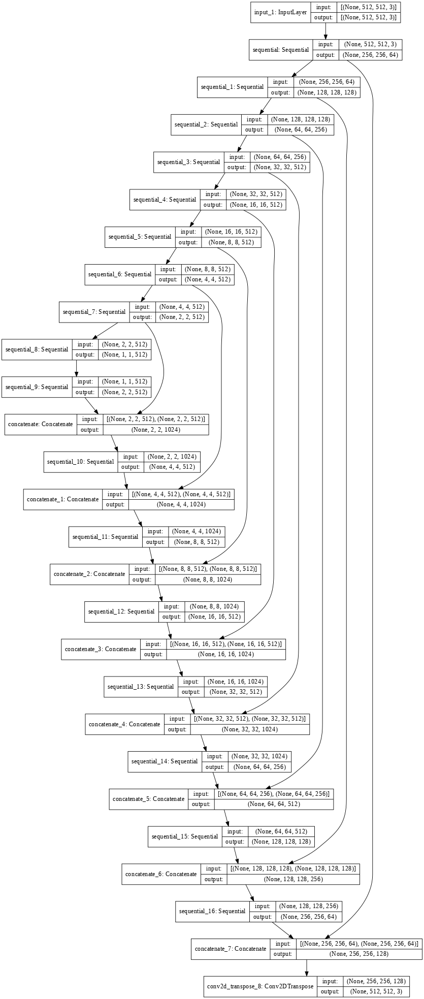

In [ ]:
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

In [ ]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

In [ ]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[512, 512, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[512, 512, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (bs, 64, 64, 128)
  down3 = downsample(128, 4)(down2)
  down4 = downsample(256, 4)(down3)  # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

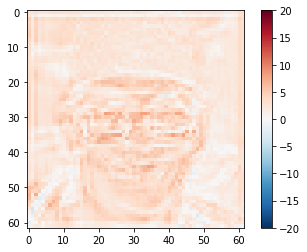

In [ ]:
discriminator = Discriminator()
#tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)


disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

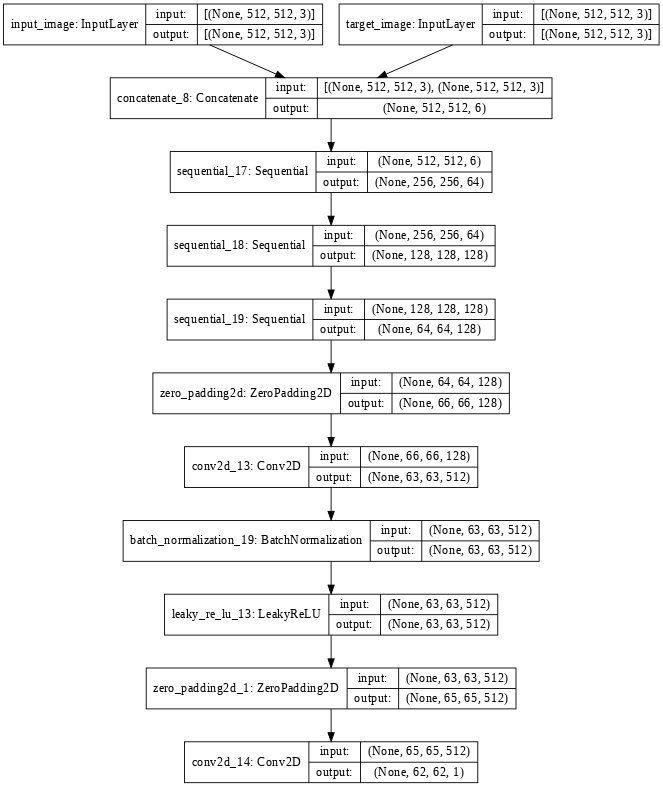

In [ ]:
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

In [ ]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


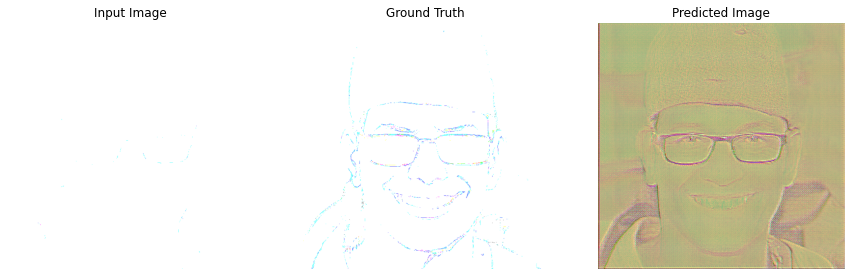

In [ ]:
##training
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)



checkpoint_dir = 'training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()


#for example_input, example_target in train_dataset_inp.take(1),train_dataset_real.take(1):
generate_images(generator, inp[tf.newaxis, ...], real[tf.newaxis, ...])

In [ ]:
EPOCHS = 30
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [ ]:
import time
from IPython import display

#@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))
  
  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [ ]:
def fit(train_dataset_inp, epochs, train_dataset_real):
  for epoch in range(epochs):
    start = time.time()
    print("Epoch: ", epoch)

    # Train
    n=0
    for input_image, target in zip(train_dataset_inp,train_dataset_real):
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      train_step(input_image, target, epoch)
      n=n+1
    print()
    display.clear_output(wait=True)
    
    generate_images(generator, input_image, target)
    # saving (checkpoint) the model every 20 epochs
    if epoch + 1 == 3:
      checkpoint.save(file_prefix=checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
  checkpoint.save(file_prefix=checkpoint_prefix)

In [ ]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

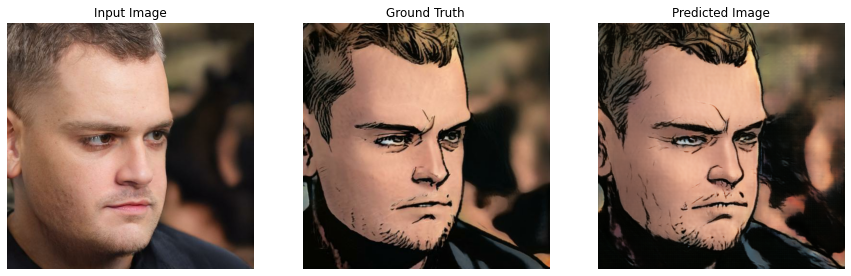

Time taken for epoch 30 is 776.9623117446899 sec



In [ ]:
fit(train_dataset_inp,EPOCHS,train_dataset_real)

In [ ]:
display.IFrame(
    src="https://tensorboard.dev/experiment/lZ0C6FONROaUMfjYkVyJqw",
    width="100%",
    height="1000px")

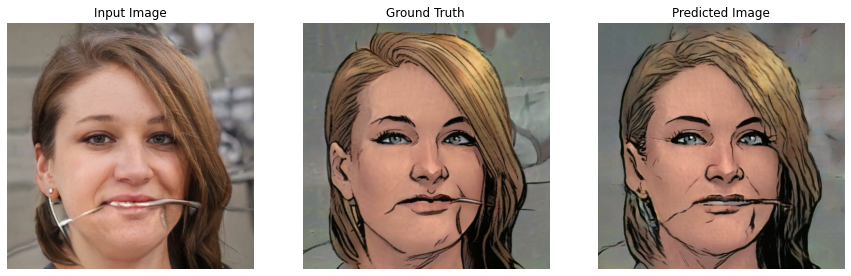

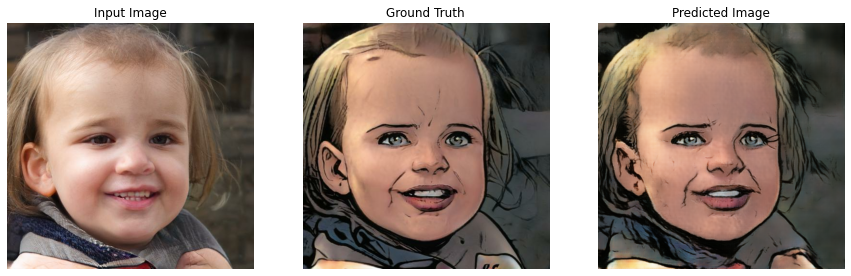

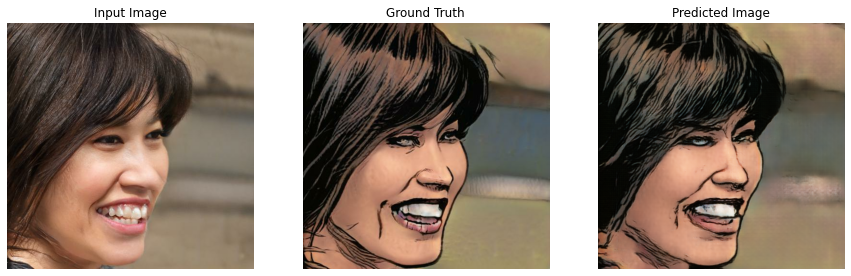

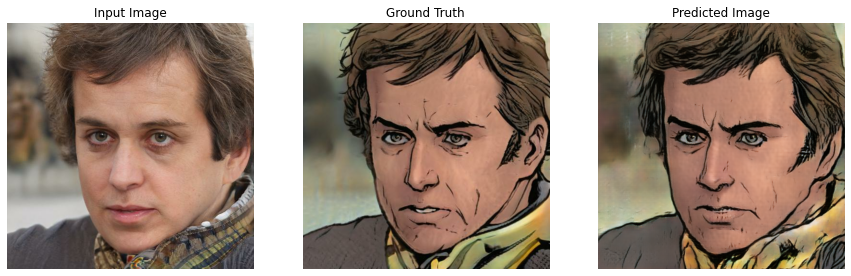

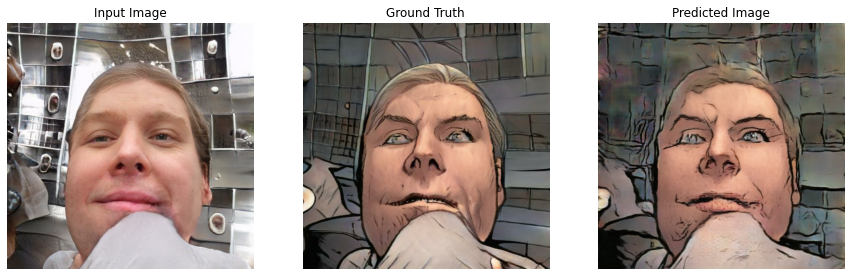

...

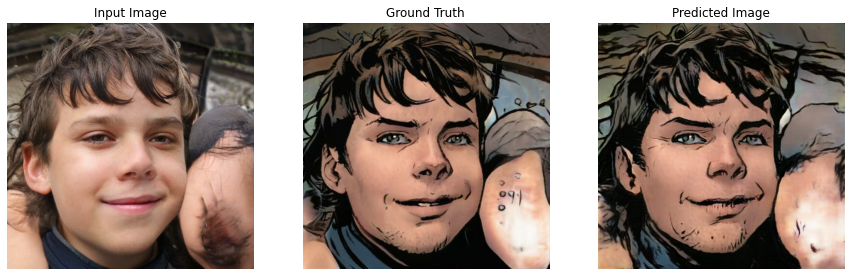

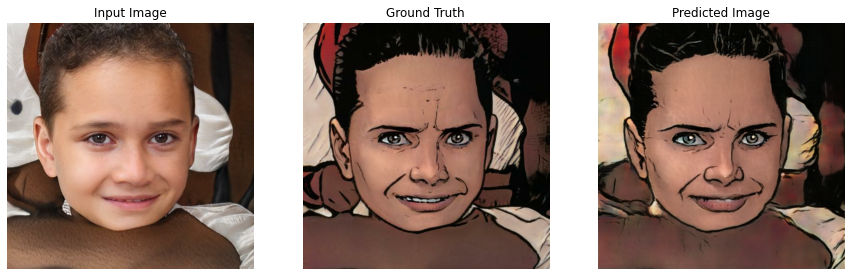

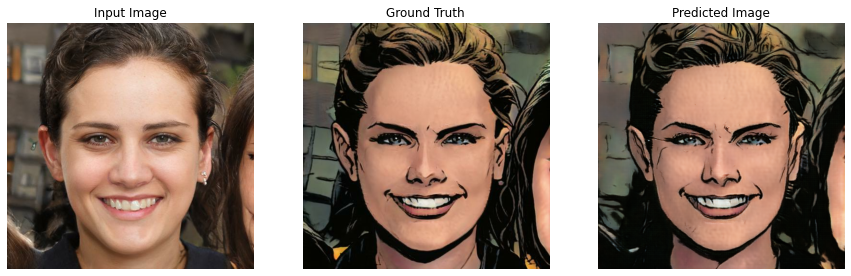

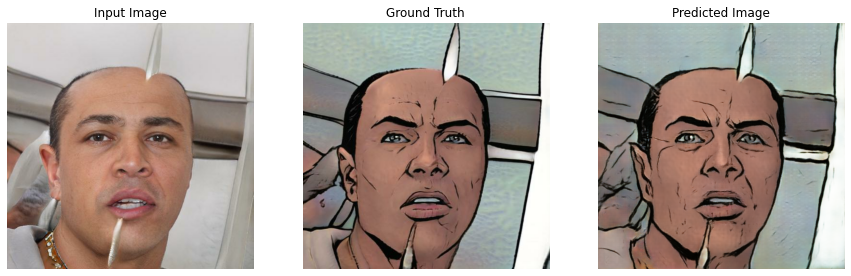

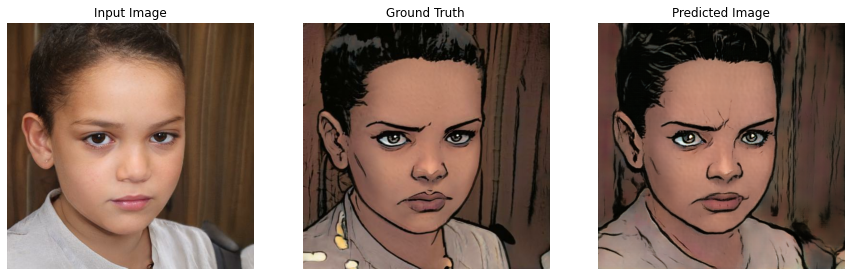

In [ ]:
k=0
for input_image, target in zip(train_dataset_inp,train_dataset_real):
      #print(target)
      generate_images(generator, input_image, target)
      k=k+1
      if k==20:
            break

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


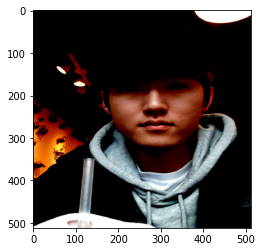

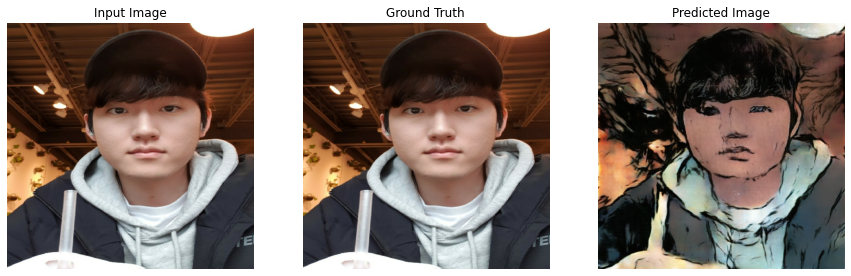

In [ ]:
input_image=load_image_train('/content/drive/My Drive/sample_test.jpg')
input_image=resize(input_image,512,512)
input_image=input_image[:,:,:3]
plt.imshow(input_image)
generate_images(generator,input_image[tf.newaxis, ...],input_image[tf.newaxis, ...])

In [ ]:
generator.save('pix2pix_model.h5')